# Image Captioning Model - Inference

## Preparing the validation data

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from helpers import *

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\User\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [4]:
# Select appropriate values for the Python variables below.
batch_size = 32          # batch size
vocab_threshold = 3        # minimum word count threshold
vocab_from_file = True    # if True, load existing vocab file

In [373]:
# Obtaining the Test loader

# Create the test data loader.
transform_test = transforms.Compose([ 
    transforms.Resize((224,224)),                          # smaller edge of image resized to 256
    transforms.ToTensor(),                           # convert the PIL Image to a tensor
    transforms.Normalize((0.485, 0.456, 0.406),      # normalize image for pre-trained model
                         (0.229, 0.224, 0.225))])

test_loader = get_loader(transform=transform_test,    
                         mode='test', batch_size=1, vocab_file = './vocab_2.pkl' )


Vocabulary successfully loaded from ./vocab_2.pkl file!
loading annotations into memory...
Done (t=0.12s)
creating index...
index created!


## Modelling

In [8]:
from model import *

In [9]:
# Setting hyperparameters of the trained model

# Select appropriate values for the Python variables below.
batch_size = 32          # batch size
vocab_threshold = 3        # minimum word count threshold
vocab_from_file = True    # if True, load existing vocab file
embed_size = 512           # dimensionality of image and word embeddings
hidden_size = 512         # number of features in hidden state of the RNN decoder
num_epochs = 6             # number of training epochs
save_every = 1             # determines frequency of saving model weights
print_every = 100          # determines window for printing average loss
num_layers=2
drop_prob=0.4

# The size of the vocabulary.
vocab_size = len(test_loader.dataset.vocab)

# Move tensor to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
if torch.cuda.is_available():
    print("GPU:",torch.cuda.get_device_name(0))

In [10]:
# Initialize the encoder and decoder. 
encoder = EncoderCNN(embed_size)
decoder = DecoderRNN(embed_size, hidden_size, vocab_size, num_layers=num_layers, drop_prob=drop_prob)

# Move models to GPU if CUDA is available. 
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
encoder.to(device)
decoder.to(device)


print("Cuda available:", torch.cuda.is_available())

# Define the loss function. 
criterion = nn.CrossEntropyLoss().cuda() if torch.cuda.is_available() else nn.CrossEntropyLoss()

# TODO #3: Specify the learnable parameters of the model.
params = list(decoder.parameters()) + list(encoder.embed.parameters()) 

# TODO #4: Define the optimizer.
optimizer = Adam(params)

# Set the total number of training steps per epoch.
total_step = math.ceil(len(data_loader.dataset.caption_lengths) / data_loader.batch_sampler.batch_size)

Cuda available: False


## Load the weights of the trained model

In [11]:
# Generate Predictions
# Specify the saved models to load.

encoder_file = 'models/encoder-2019-11-26_b32_vt3_embed512_hidden512_ep6_step18494.pkl'
decoder_file = 'models/decoder-2019-11-26_b32_vt3_embed512_hidden512_ep6_step18494.pkl'


# Initialize the encoder and decoder, and set each to inference mode.
eval_encoder = EncoderCNN(embed_size)
eval_encoder.eval()
eval_decoder = DecoderRNN(embed_size, hidden_size, vocab_size, num_layers=num_layers)
eval_decoder.eval()

# Load the trained weights.
if torch.cuda.is_available(): 
    eval_decoder.load_state_dict(torch.load(decoder_file))
    eval_encoder.load_state_dict(torch.load(encoder_file))
else:
    eval_decoder.load_state_dict(torch.load(decoder_file, map_location='cpu'))
    eval_encoder.load_state_dict(torch.load(encoder_file, map_location='cpu'))
print(f"Encoder loaded from:{encoder_file}\nDecoder loaded from:{decoder_file}")
# Move models to GPU if CUDA is available.
eval_encoder.to(device)
eval_decoder.to(device)

Encoder loaded from:models/encoder-2019-11-26_b32_vt3_embed512_hidden512_ep6_step18494.pkl
Decoder loaded from:models/decoder-2019-11-26_b32_vt3_embed512_hidden512_ep6_step18494.pkl


DecoderRNN(
  (word_embeddings): Embedding(13423, 512)
  (lstm): LSTM(512, 512, num_layers=2, batch_first=True, dropout=0.2)
  (dropout): Dropout(p=0.2)
  (scores): Linear(in_features=512, out_features=13423, bias=True)
)

In [69]:
def get_text(_in, vocab_file = test_loader.dataset.vocab, stop=True):
    '''
    Function to convert a list of integers output from the decoder 
    into the corresponding words, based on the supplied vocabulary dictionary
    '''
    
    sentence = []
    for token in _in:
        word = vocab_file.idx2word.get(token)
        if word == "." or word == "<end>":
            sentence.append(".")
            if stop:
                break
        elif word == "<start>":
            pass
        else:
            sentence.append(word)
    return " ".join(sentence).capitalize()

In [386]:
from collections import OrderedDict
bweights = OrderedDict([ (1, (1, 0, 0, 0)), (2,(0.5, 0.5, 0,0)),( 3, (0.33, 0.33, 0.33, 0)), (4, (0.25, 0.25 ,0.25, 0.25))])

bweights.items()

odict_items([(1, (1, 0, 0, 0)), (2, (0.5, 0.5, 0, 0)), (3, (0.33, 0.33, 0.33, 0)), (4, (0.25, 0.25, 0.25, 0.25))])

In [383]:
ordict.keys()

odict_keys([1, 2, 3, 4])

In [413]:
from nltk.translate.bleu_score import sentence_bleu
from collections import OrderedDict
def get_bleu_score(ref, sentence, bgram=4, pretty=False):
    bweights = OrderedDict([ (1, (1, 0, 0, 0)), (2,(0.5, 0.5, 0,0)),( 3, (0.33, 0.33, 0.33, 0)), (4, (0.25, 0.25 ,0.25, 0.25))])
    ref = [[ w.lower() for w in ref.split(" ") ]]
    sen = [w.lower() for w in sentence.split(" ")]
    
    if bgram == 'all':
        score = [ sentence_bleu(ref, sen, weights=w) for g, w in bweights.items() ]
        if pretty:
            score = [ f'BLEU-{i+1} Score: {s:.2f}' for i,s in enumerate(score)]
    else:
        weights = bweights.get(bgram)
        if not weights:
            print("Invalid BLEU gram parameter provided. Default to 4")
            bgram=4
            weights = bweights.get(bgram)
        score = [sentence_bleu(ref, sen, weights= bweights.get(bgram)) ]
        if pretty:
            score = [f'BLEU-{bgram} Score: {score[0]}']
    
        
    return score
get_bleu_score("A large airplane is taking off from the runway.","A large airplane is flying through the air on a sunny day .", "all", True)

['BLEU-1 Score: 0.38',
 'BLEU-2 Score: 0.31',
 'BLEU-3 Score: 0.26',
 'BLEU-4 Score: 0.20']

In [408]:
def get_prediction(i=0, save = False, dataset='val', loader=test_loader):
    if dataset=='val':
      orig_image, image, captions = next(iter(test_loader))
    elif dataset == 'train':
      image, _ = next(iter(data_loader))
      image = image[0,:,:,:].unsqueeze(0)
      orig_image = image.permute(0,2,3,1)
    else:
      pil_image = Image.open(dataset).convert('RGB')
      orig_image = np.array(pil_image)
      image = loader.dataset.transform(pil_image).unsqueeze(0)
    
    print(captions)
    image = image.to(device)
    features = eval_encoder(image).unsqueeze(1)
    output = eval_decoder.predict(features)    
    sentence = get_text(output)
    
    plt.figure(figsize=(12,10))
    ax = plt.axes() 
    # remove spines
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    # Hide ticks
    ax.xaxis.set_major_locator(plt.NullLocator())
    ax.yaxis.set_major_locator(plt.NullLocator())
    
    plt.imshow(np.squeeze(orig_image))
    plt.xlabel("Generated: " + sentence + "\nActual: " + captions[0],fontsize=15, color="grey")
    if save:
        plt.savefig(f'samples/sample_{i:03}.png',bbox_inches='tight')
    plt.show()
    return sentence
    

## Good Predictions

('A person at an airport terminal with planed in view outside of the windows.',)


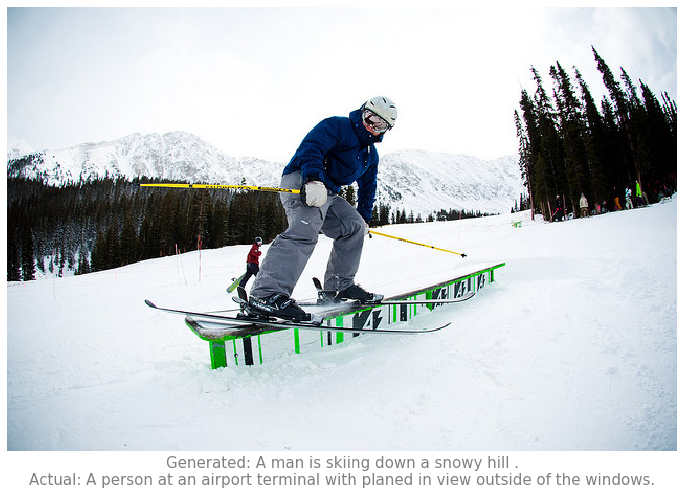

In [411]:
sen = get_prediction()

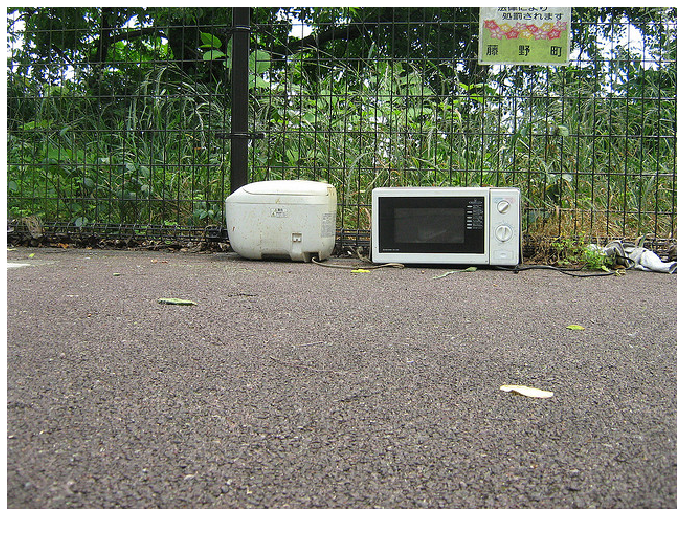

'A white and black cat sitting on a window sill .'

In [376]:
get_prediction()

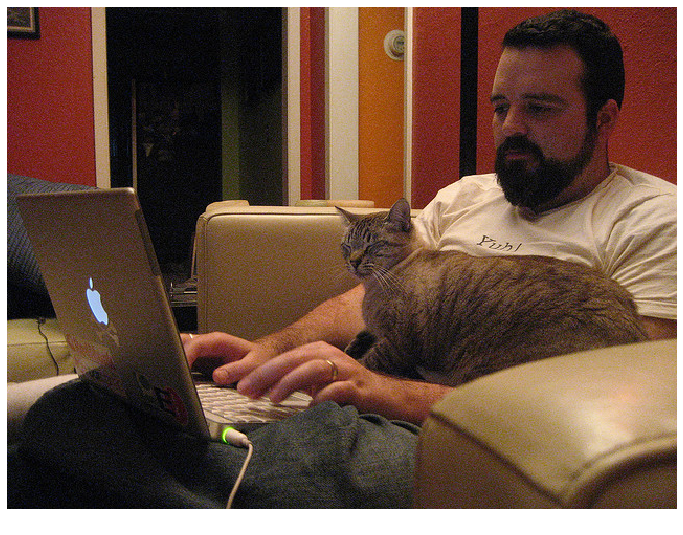

'A man is sitting on a couch with a laptop computer .'

In [337]:
get_prediction()

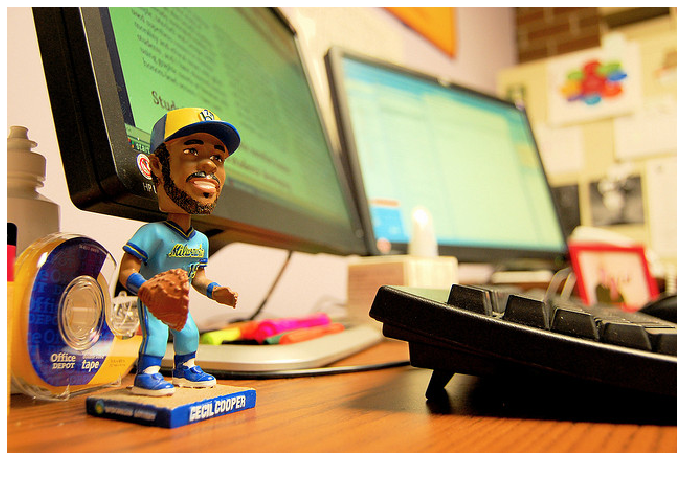

In [120]:
get_prediction()

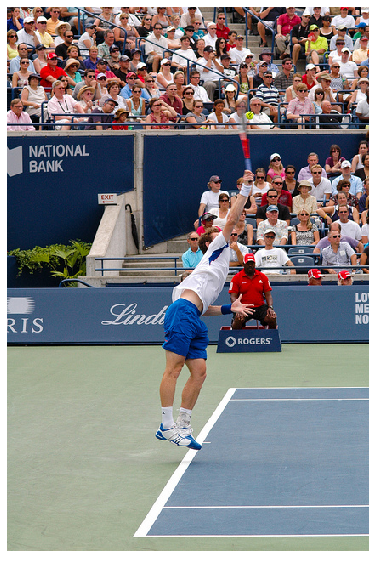

In [74]:
get_prediction()

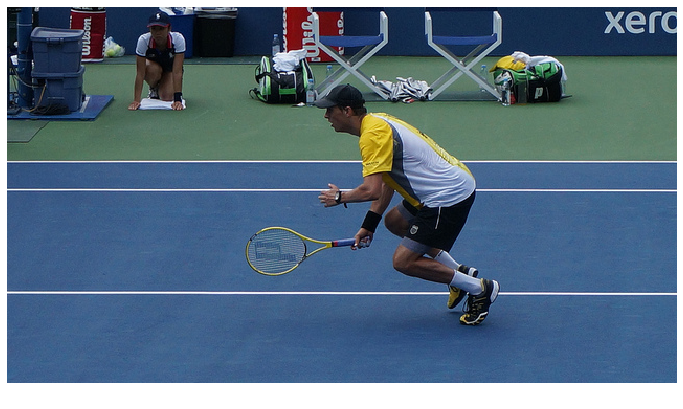

In [80]:
get_prediction()

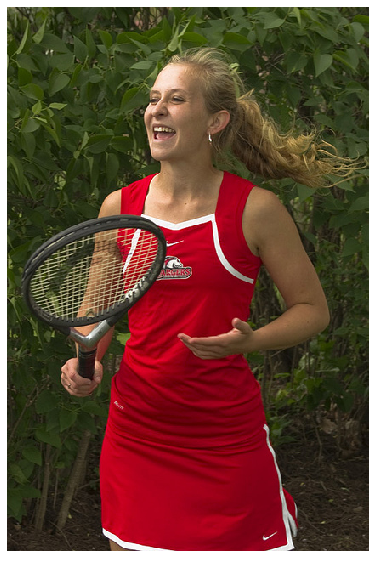

In [81]:
get_prediction()

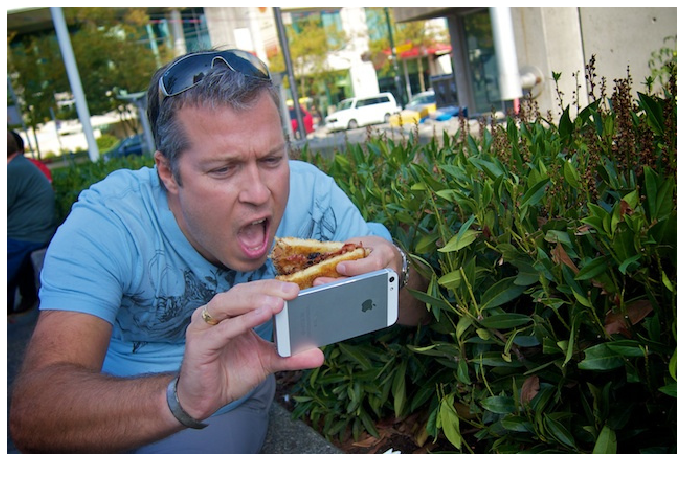

In [75]:
get_prediction()

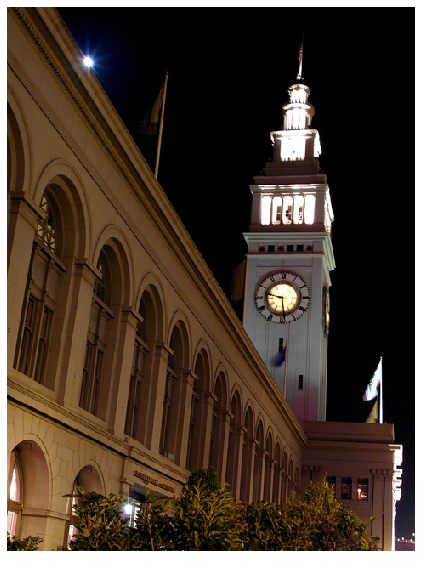

In [122]:
get_prediction()

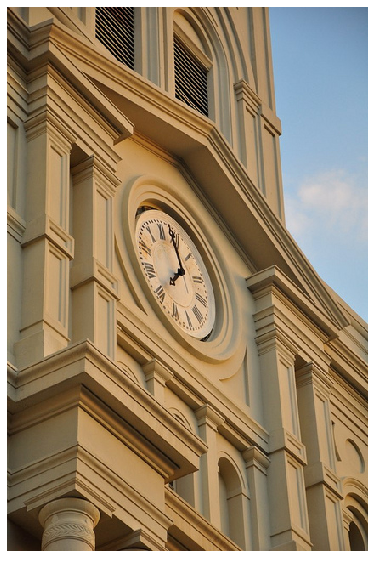

In [153]:
get_prediction()

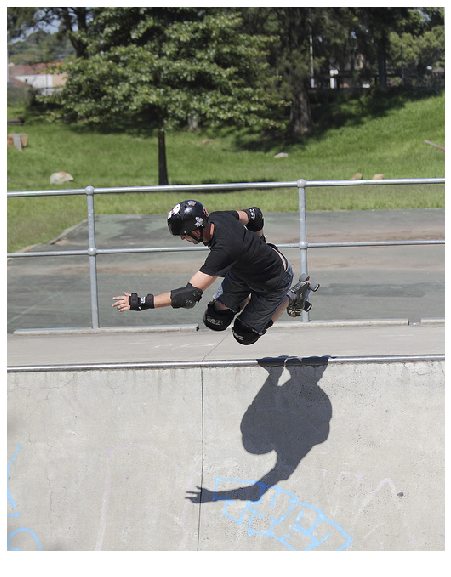

In [126]:
get_prediction()

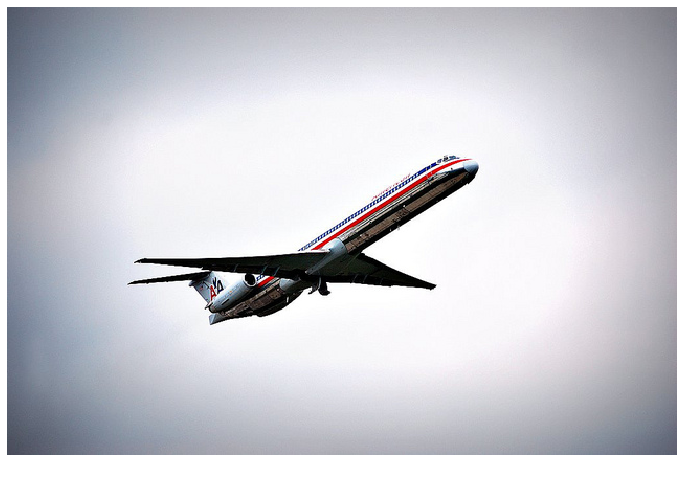

In [79]:
get_prediction()

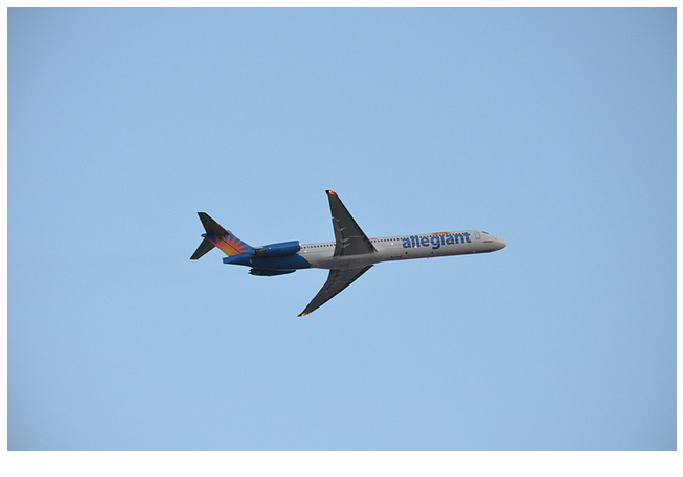

In [123]:
get_prediction()

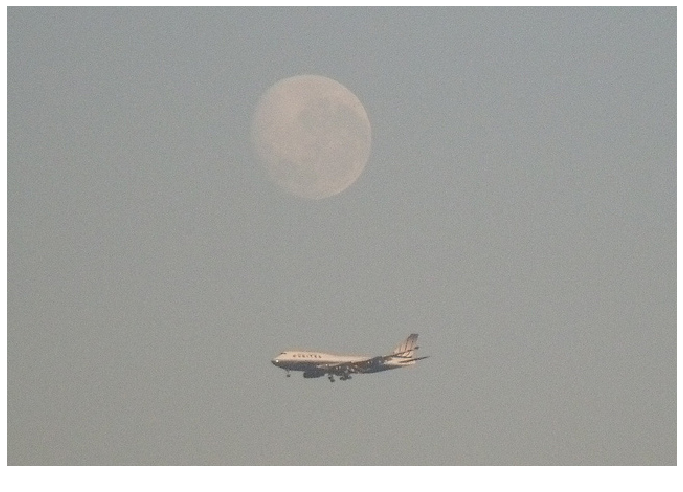

In [159]:
get_prediction()

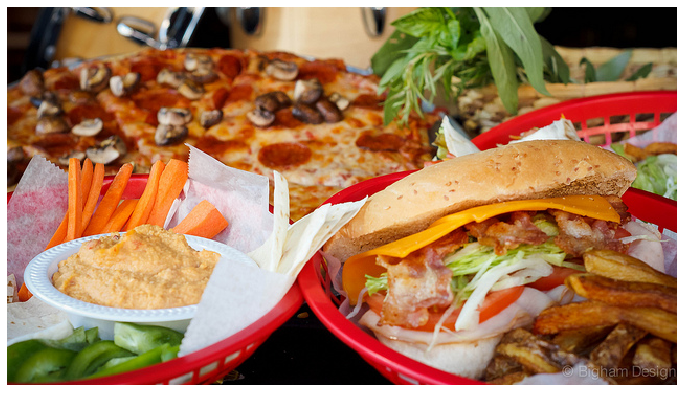

In [128]:
get_prediction()

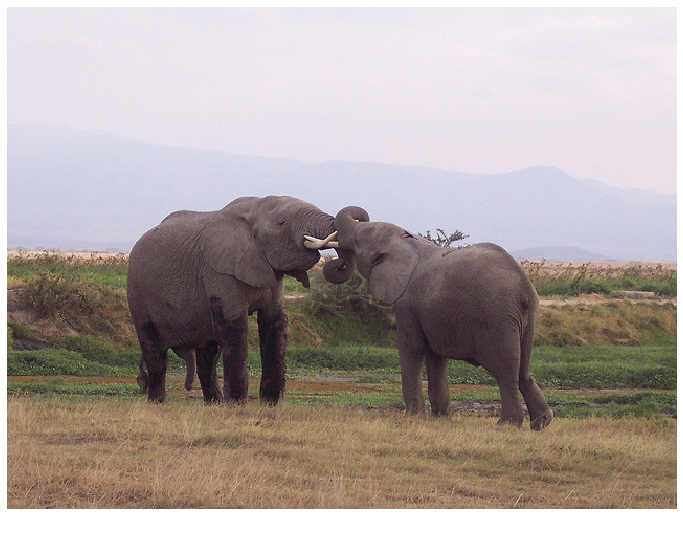

In [132]:
get_prediction()

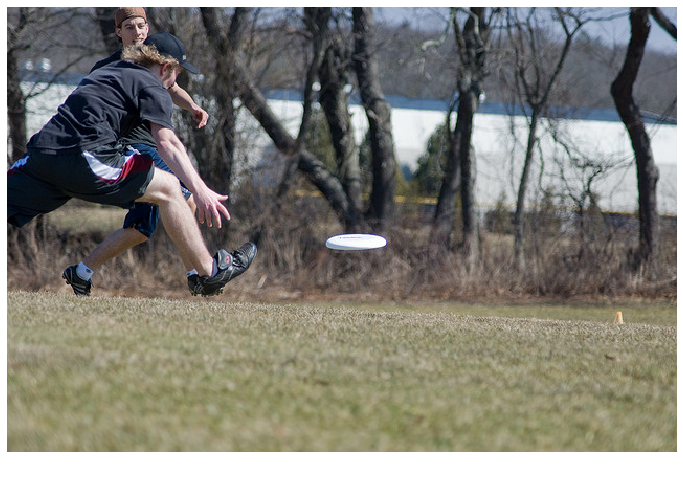

In [134]:
get_prediction()

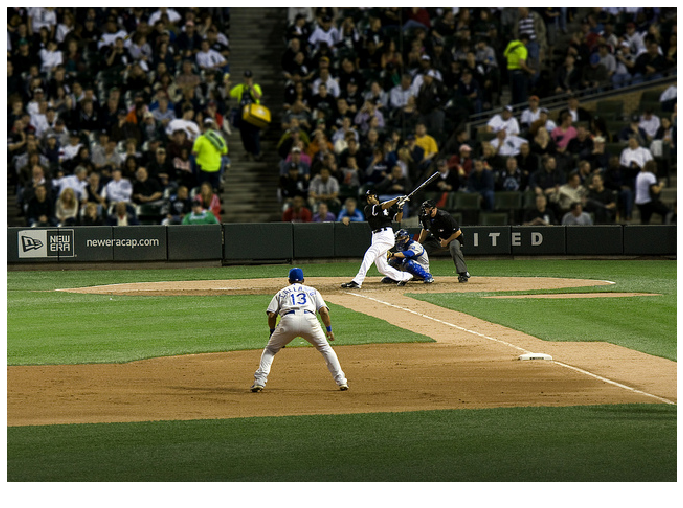

In [138]:
get_prediction()

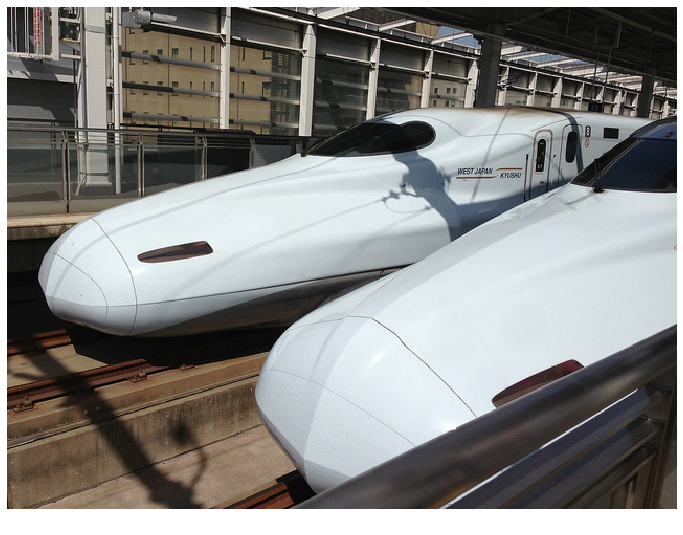

In [154]:
get_prediction()

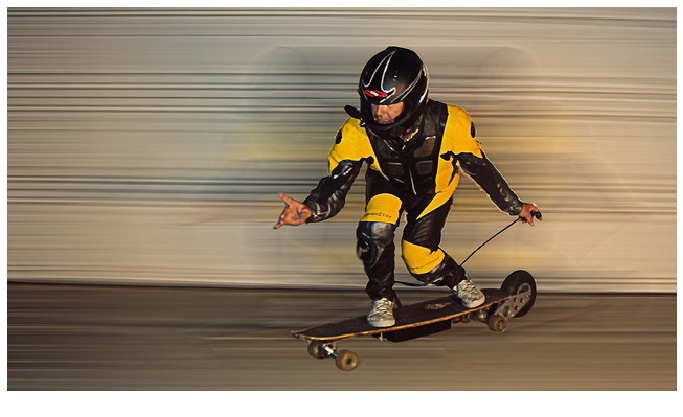

In [157]:
get_prediction()

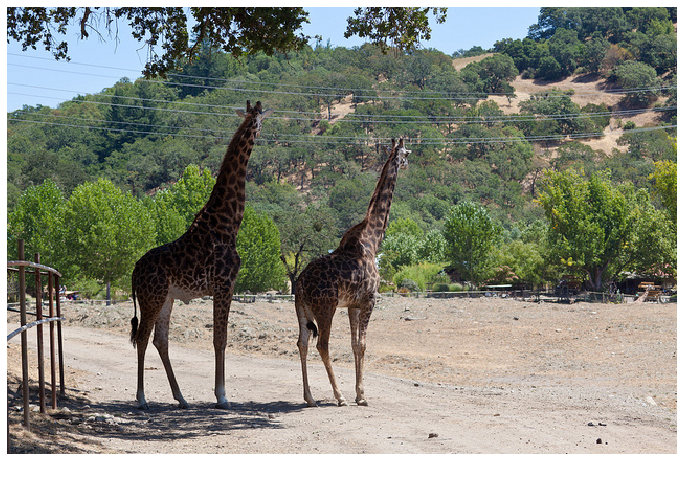

In [158]:
get_prediction()

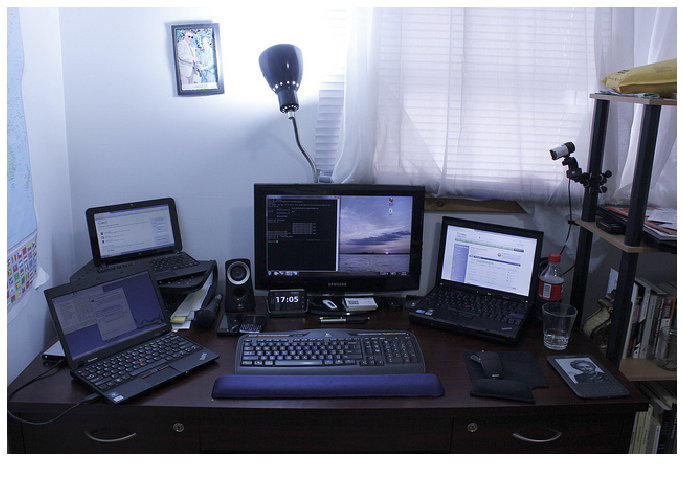

In [162]:
get_prediction()

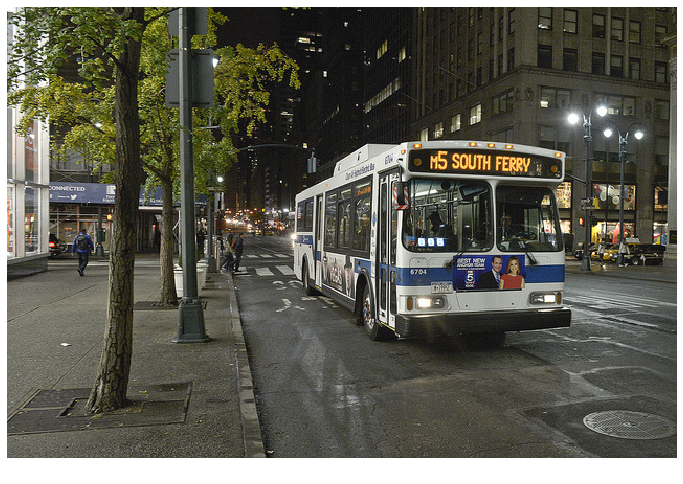

In [164]:
get_prediction()

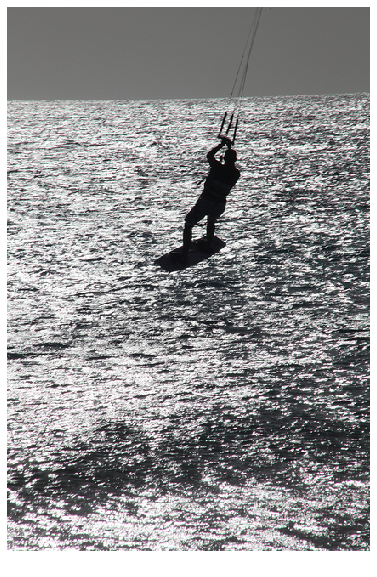

In [165]:
get_prediction()

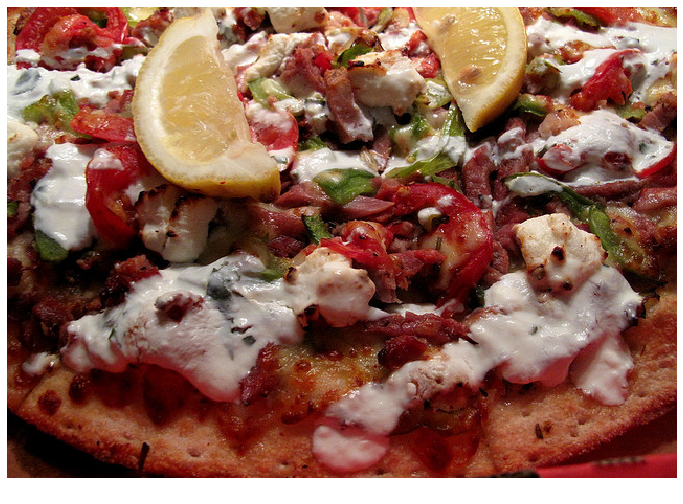

In [160]:
get_prediction()

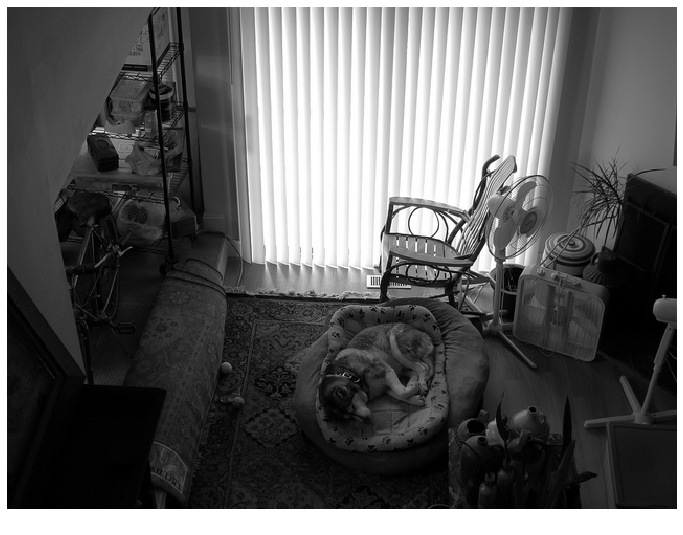

In [171]:
get_prediction()

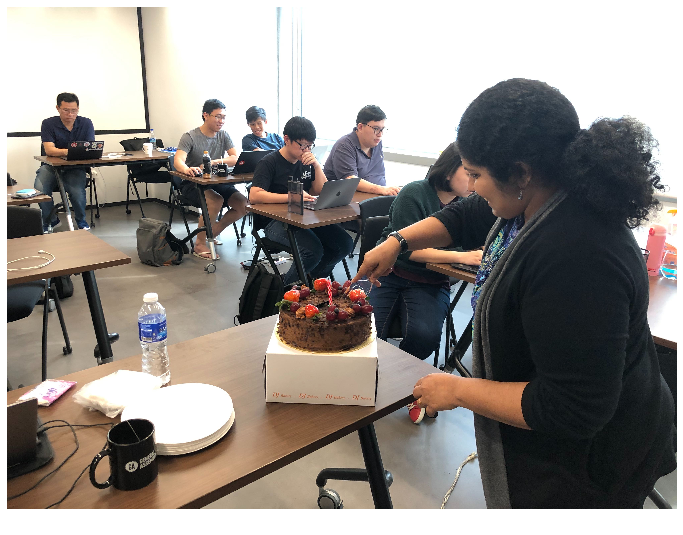

In [208]:
get_prediction(dataset='birthday1.jpg')

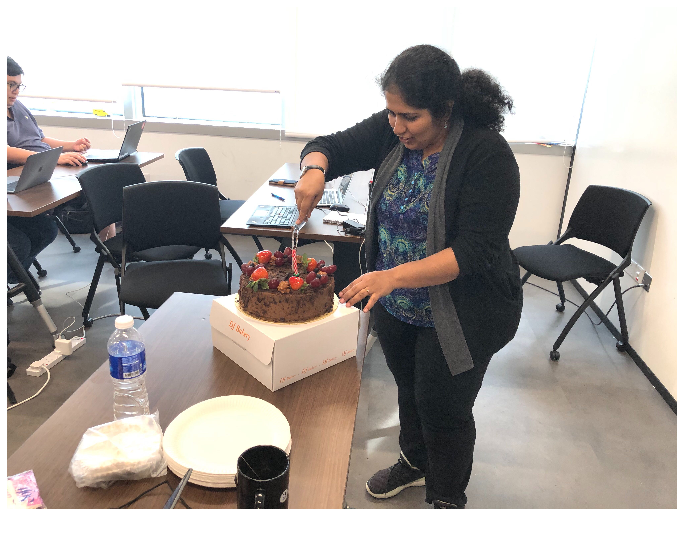

In [209]:
get_prediction(dataset='birthday2.jpg')

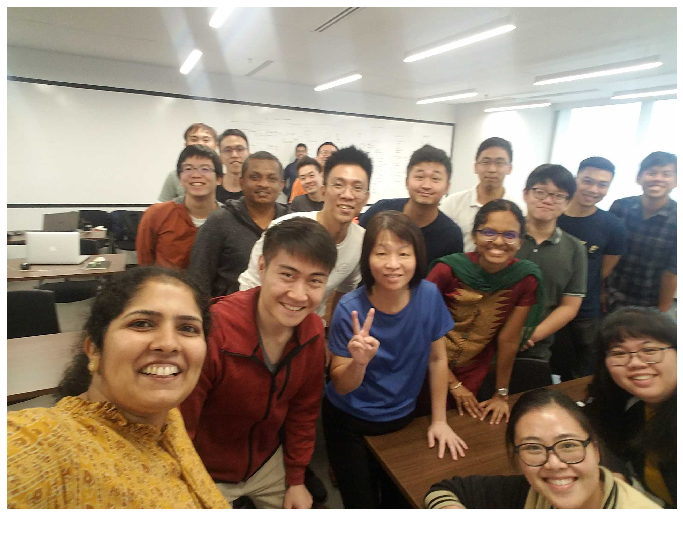

In [210]:
get_prediction(dataset='birthday3.jpg')

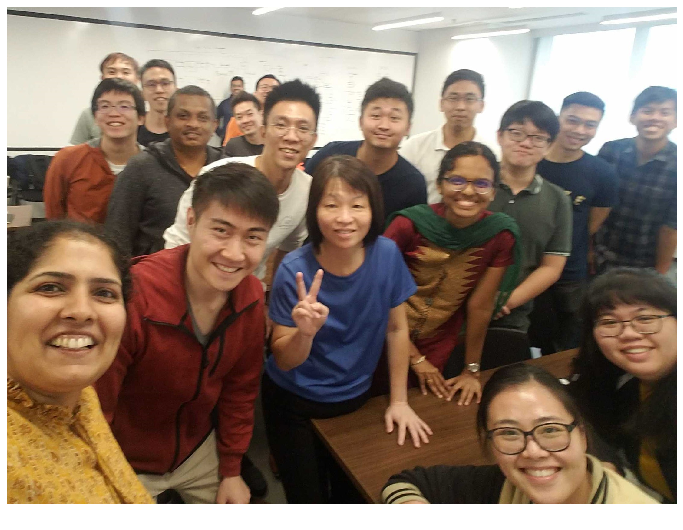

In [221]:
get_prediction(dataset='birthday3a.jpg')

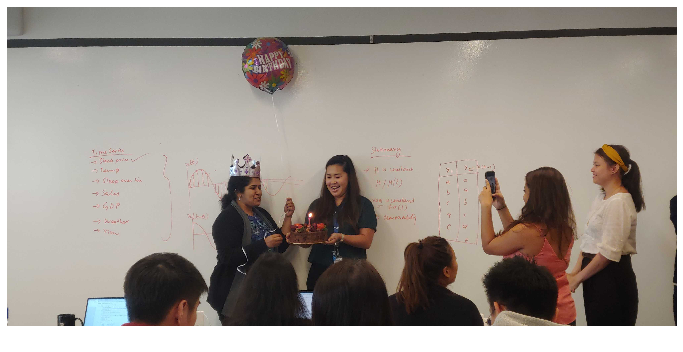

In [211]:
get_prediction(dataset='birthday4.jpg')

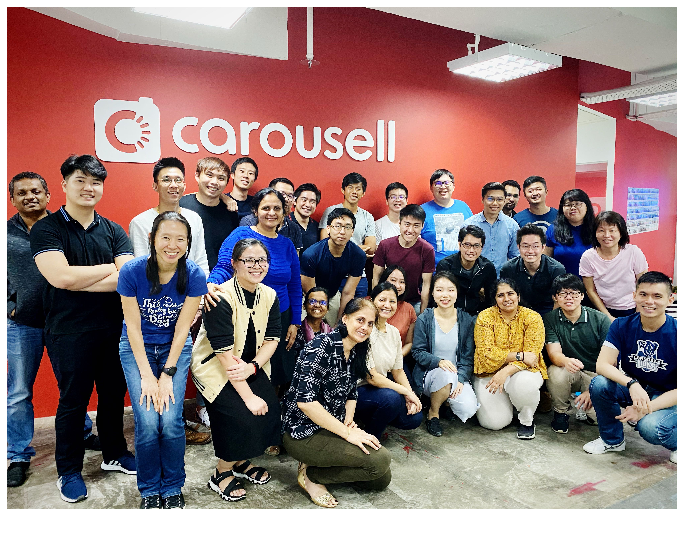

In [222]:
get_prediction(dataset='carousell.jpg')

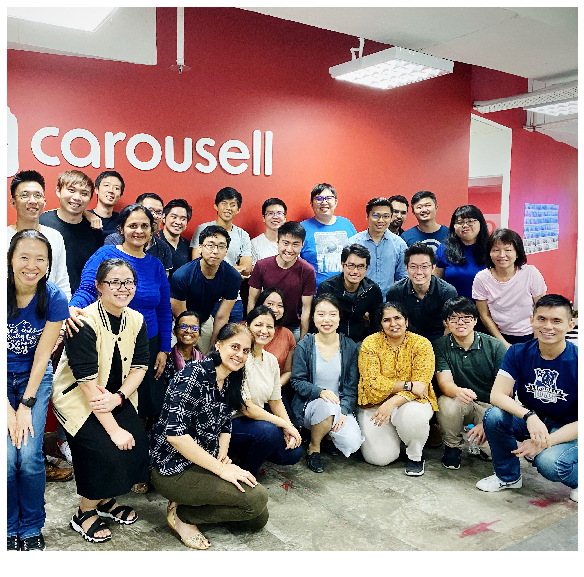

In [225]:
get_prediction(dataset='carousell2.jpg')

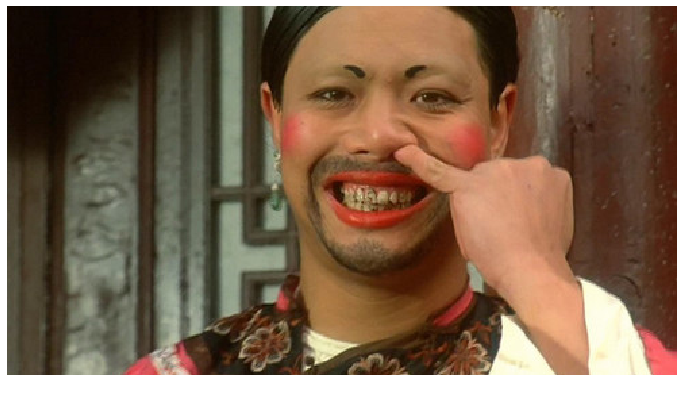

In [204]:
get_prediction(dataset='nose.png')

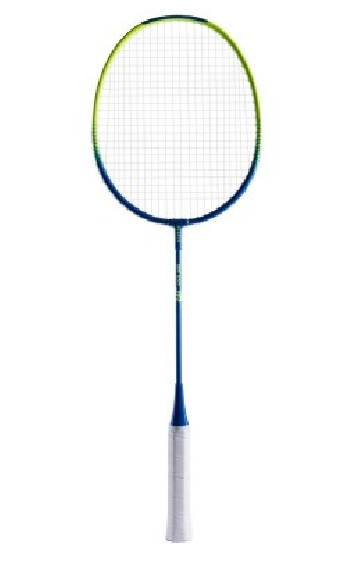

In [206]:
get_prediction(dataset='badminton.png')

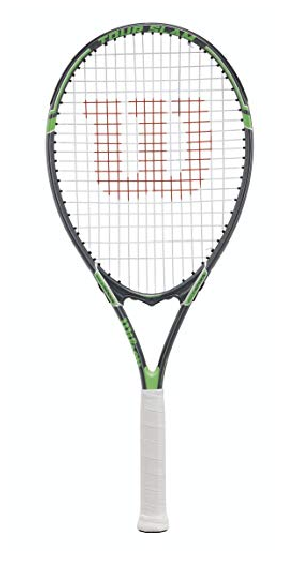

In [207]:
get_prediction(dataset='racquet.png')

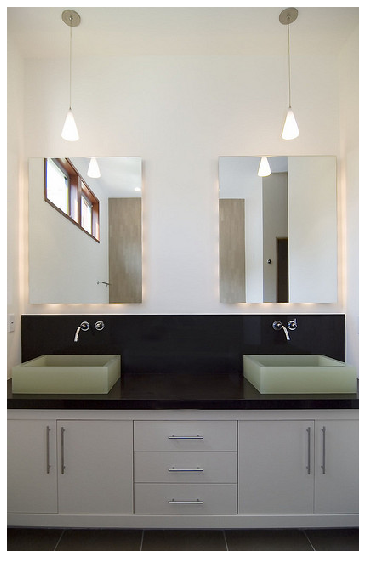

In [228]:
get_prediction()

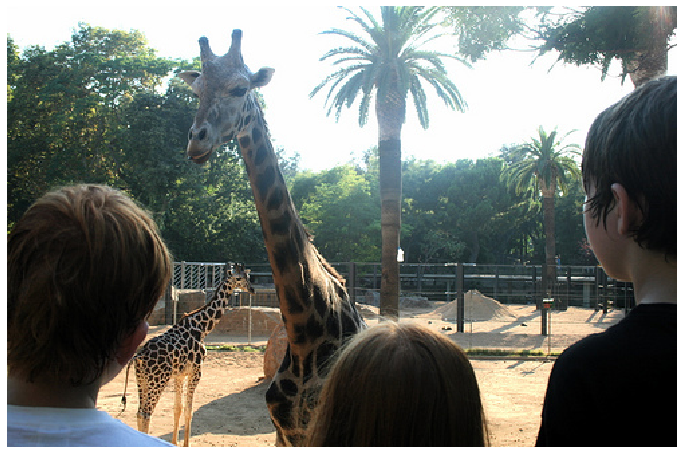

In [325]:
get_prediction()

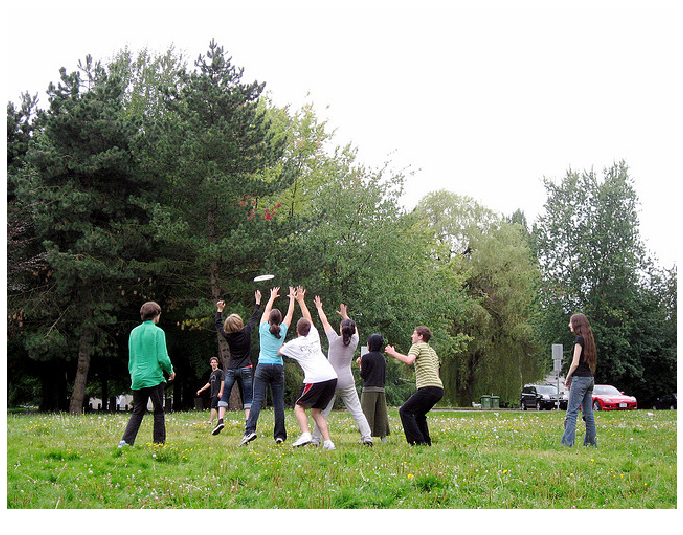

In [229]:
get_prediction()

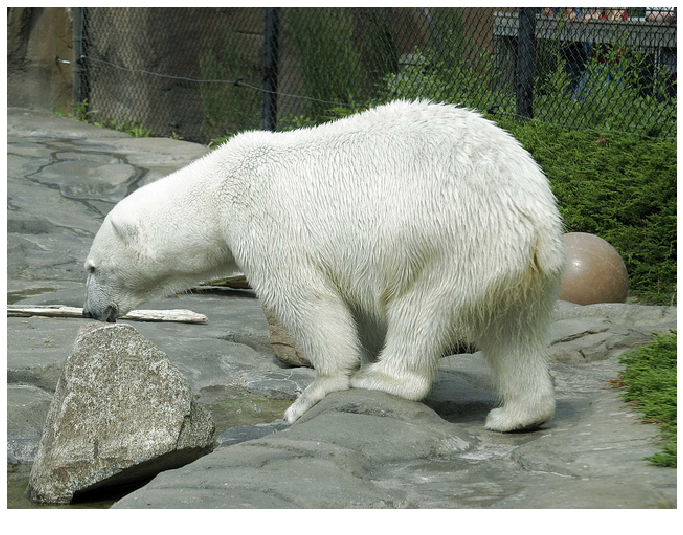

In [231]:
get_prediction()

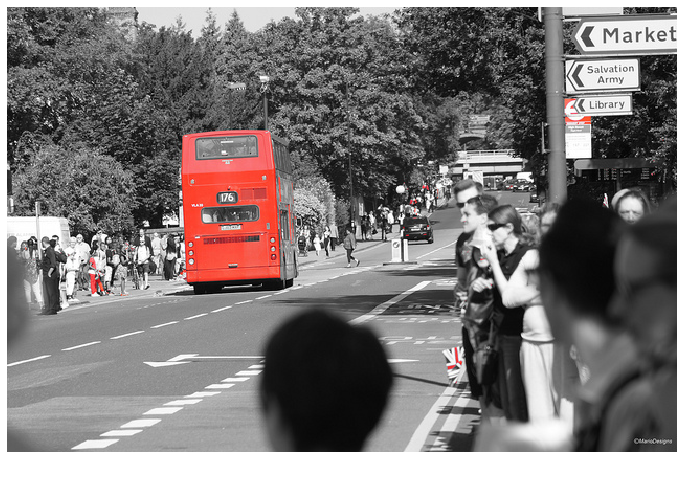

In [291]:
get_prediction()

## Challenging captions

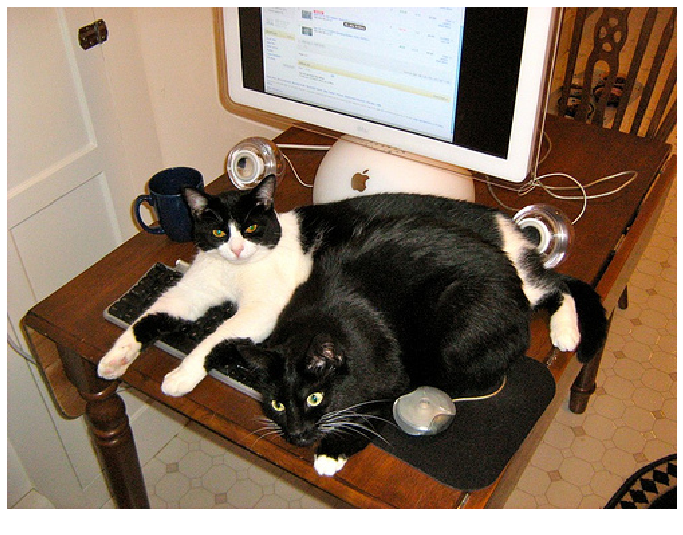

In [304]:
get_prediction()

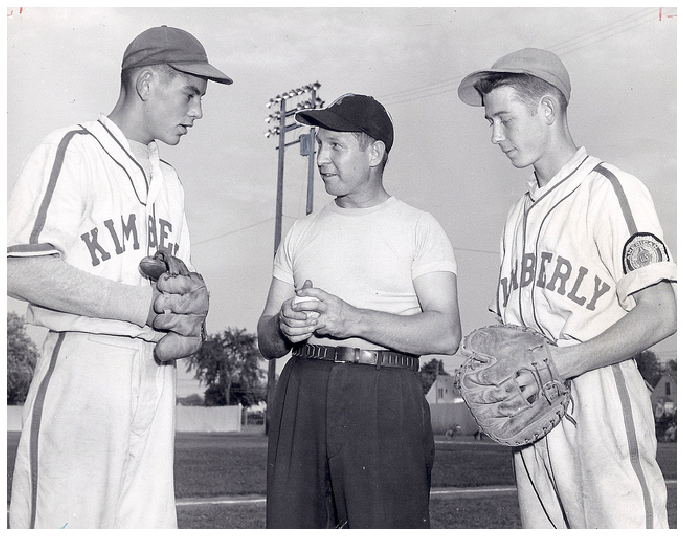

In [315]:
get_prediction()

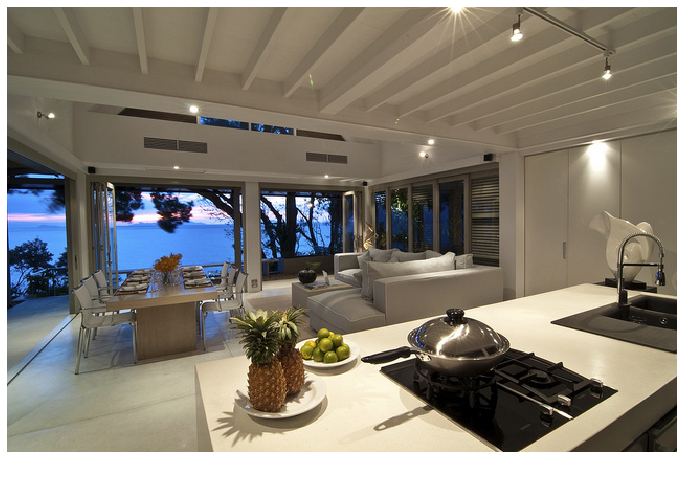

In [300]:
get_prediction()

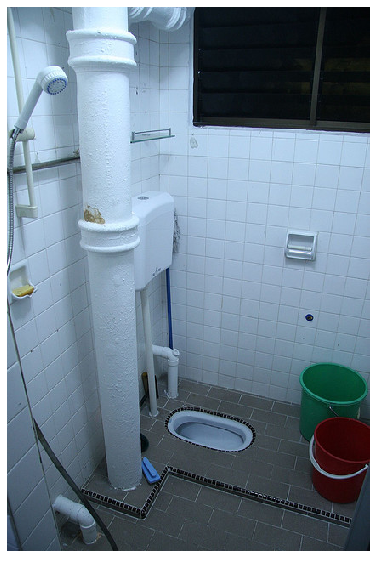

In [237]:
get_prediction()

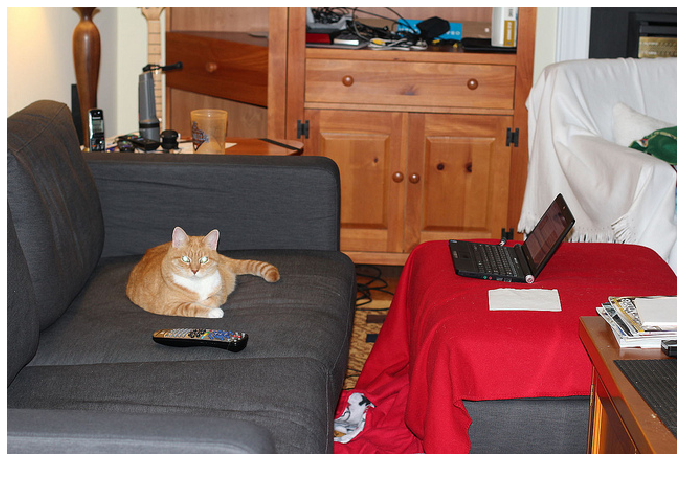

In [78]:
get_prediction()

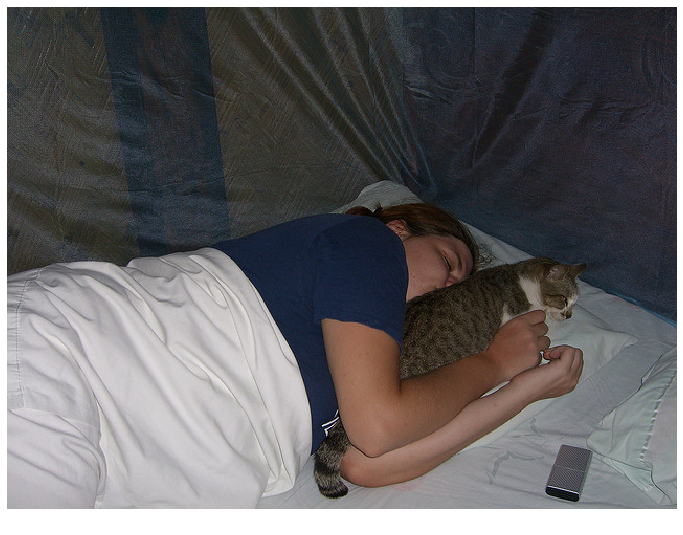

In [73]:
get_prediction()

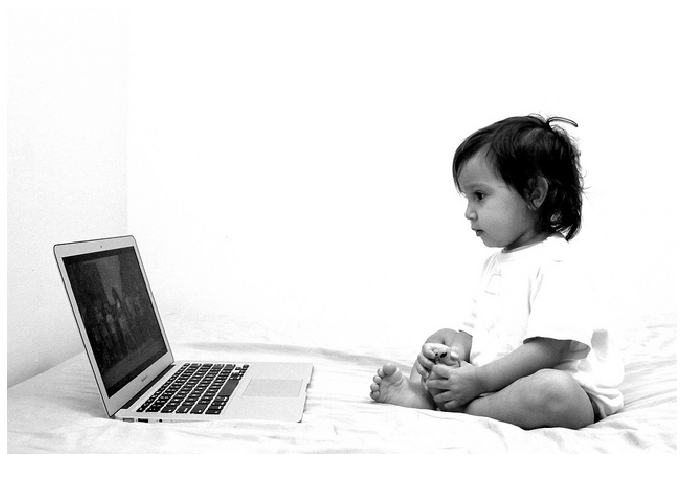

In [125]:
get_prediction()

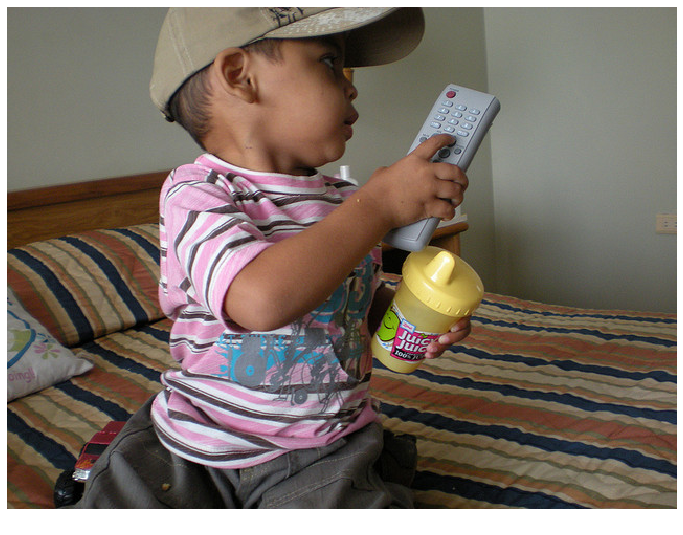

In [129]:
get_prediction()

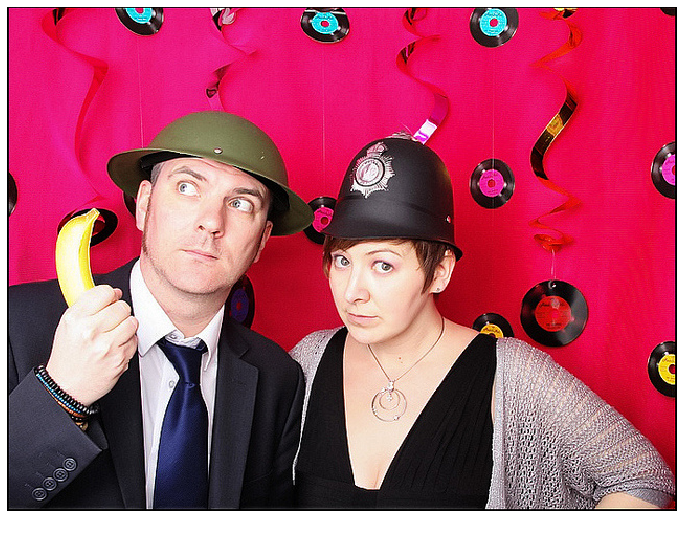

In [131]:
get_prediction()

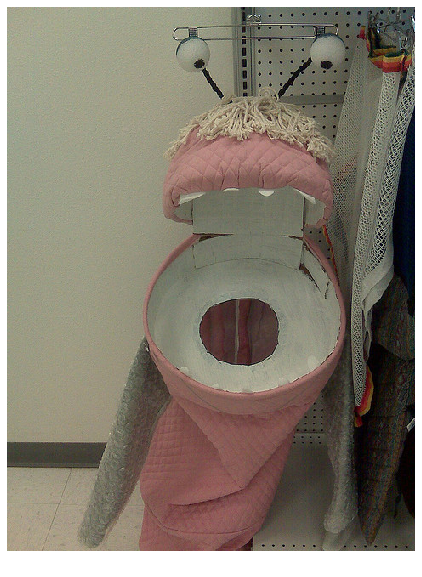

In [142]:
get_prediction()

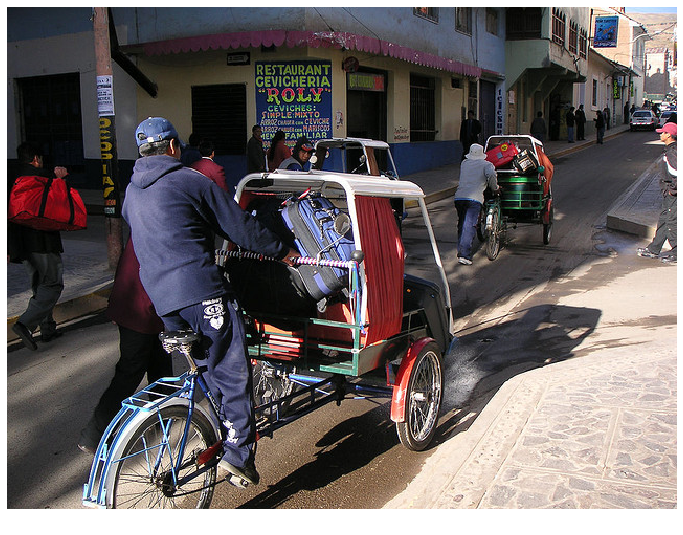

In [144]:
get_prediction()

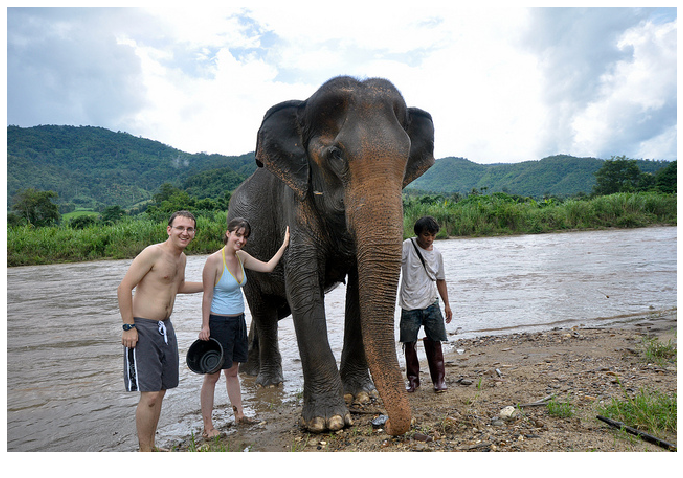

In [145]:
get_prediction()

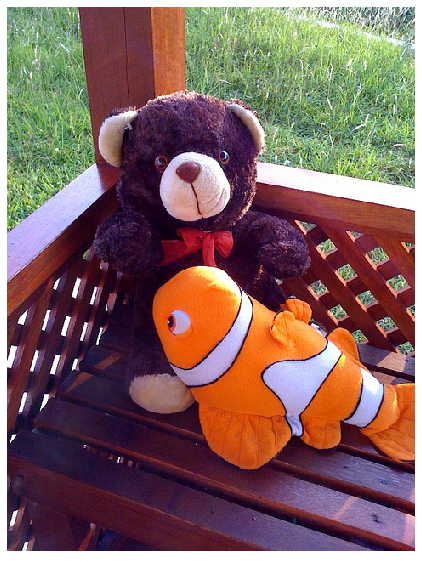

In [147]:
get_prediction()

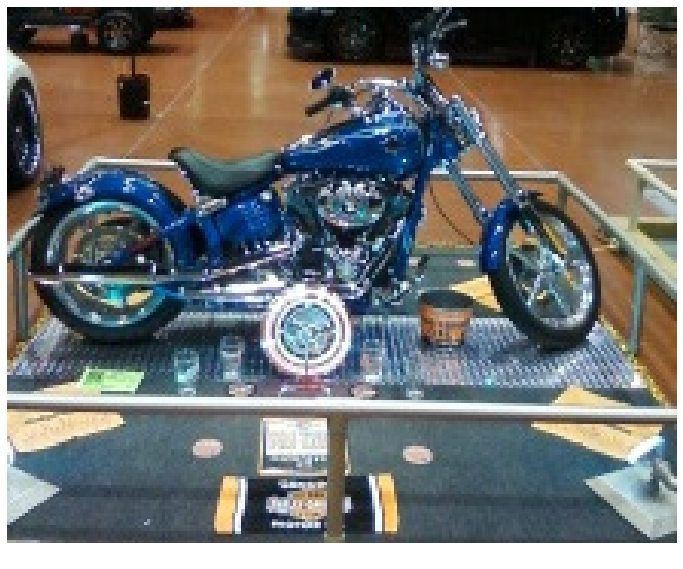

In [155]:
get_prediction()

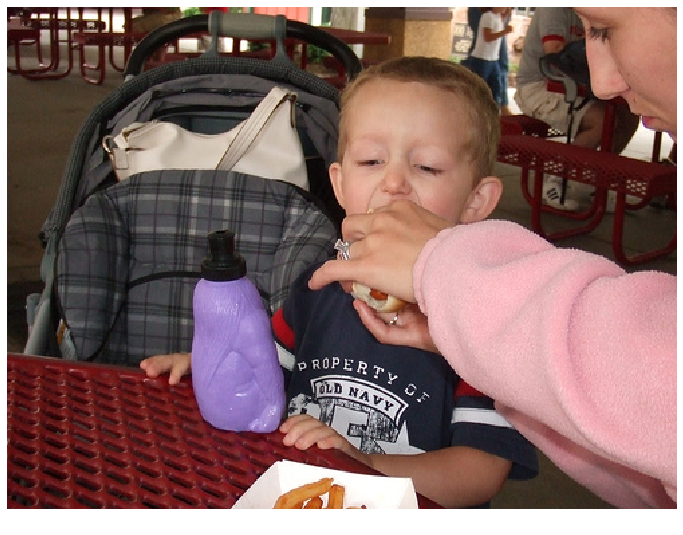

In [156]:
get_prediction()

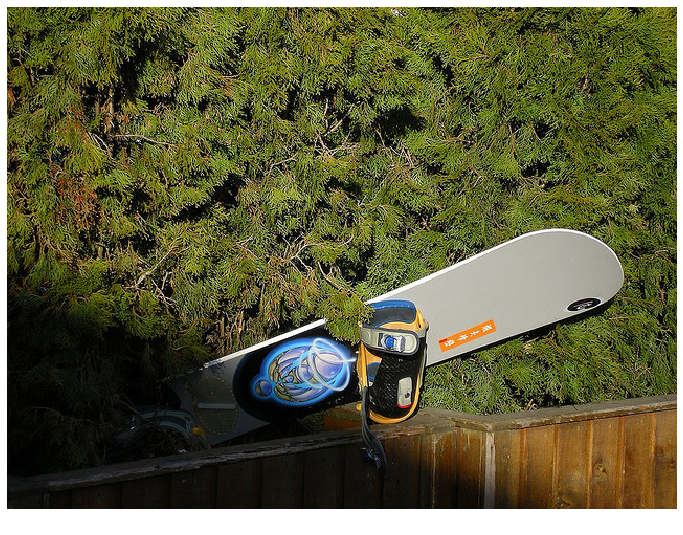

In [167]:
get_prediction()

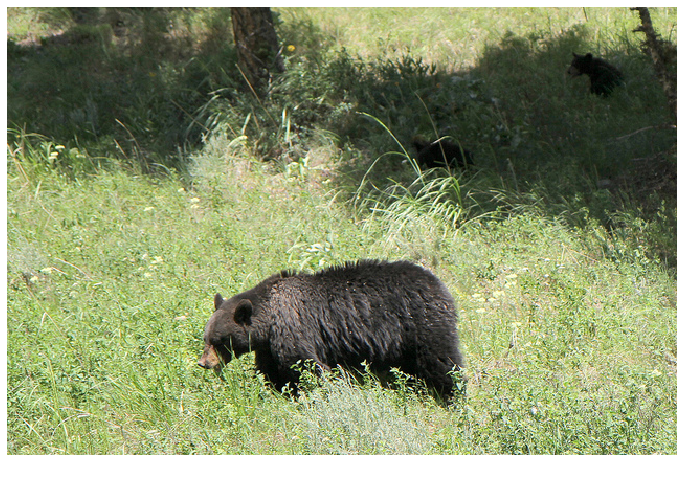

In [176]:
get_prediction()

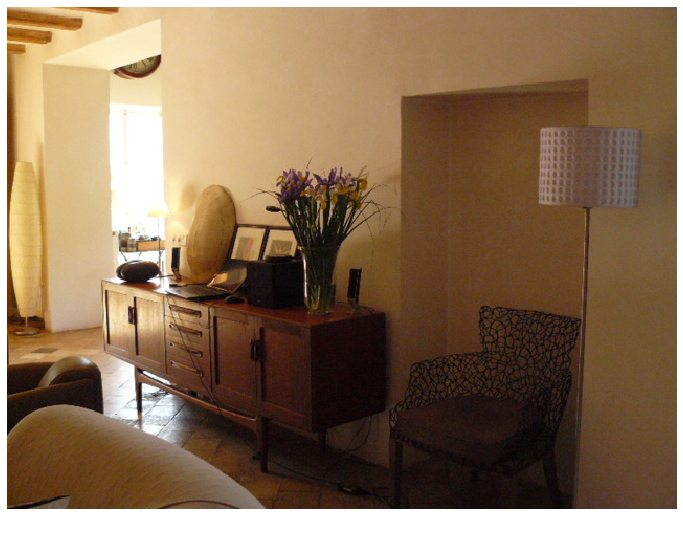

In [181]:
get_prediction()

# Model Evaluation with BLEU-4

In [370]:
from nltk.translate.bleu_score import sentence_bleu
def get_bleu_score(ref, sentence, bgram=2):
    weights = (0.25, 0.25, 0.25, 0.25)
    if bgram == 1:
        weights = (1, 0, 0, 0)
    elif bgram == 2:
        weights = (0.5, 0.5, 0,0)
    elif bgram == 3:
        weights = (0.33, 0.33, 0.33, 0)
    elif bgram == 4:
        weights = (0.25, 0.25 ,0.25, 0.25)
    ref = [[ w.lower() for w in ref.split(" ") ]]
    sen = [w.lower() for w in sentence.split(" ")]
    score = sentence_bleu(ref, sen, weights)
    return score
get_bleu_score("A large airplane is taking off with a bike.","A large airplane is flying through the air on a sunny day .")

0.31008683647302115

In [363]:
sen

'A large airplane flying through the air on a sunny day .'